In [38]:
import cv2
import matplotlib.pyplot as plt 
import numpy as np
import random

In [39]:
def show_img_cv(img_title, img):
    cv2.imshow(img_title, img)
    cv2.waitKey(0)
    cv2.destroyAllWindows()

In [40]:
def show_img_plt(img, c_map ='gray', fig_hight=6, fig_width=4, vmin=0, vmax=255):
    plt.figure(figsize=(fig_hight, fig_width), dpi=100)
    plt.imshow(img, cmap=c_map, vmin=vmin, vmax=vmax)

In [41]:
def display_hist_plt(img, bins=256, range=(0, 256)):
    plt.figure(figsize=(4, 2), dpi=100)
    plt.hist(img.flat, bins=bins, range=range)
    plt.show()

In [42]:
def show_mult_img(rows, columns, img_names, vmin=0, vmax=255):
    fig = plt.figure(figsize=(15, 17), dpi=100)
    for i in range(len(img_names)):
        fig.add_subplot(rows, columns, i+1)
        plt.imshow(img_names[i], cmap='gray', vmin=vmin, vmax=vmax)
        plt.axis('off')
        plt.title('img_' + str(i))

In [43]:
def show_mult_img_JPG_PNG(rows, columns, img_names, vmin=0, vmax=255):
    fig = plt.figure(figsize=(15, 17), dpi=100)
    for i in range(len(img_names)):
        fig.add_subplot(rows, columns, i+1)
        plt.imshow(img_names[i], cmap='gray', vmin=vmin, vmax=vmax)
        plt.axis('off')
        if i == 0:
            plt.title('img_jpg')
        elif i == 1:
            plt.title('img_png')
        else:
            plt.title('img_' + str(i))

In [44]:
def fun_Gamma(img , gamma=0.3):
    gamma_img = np.uint8(((img/255)**gamma)*255)
    return gamma_img

## Read Images

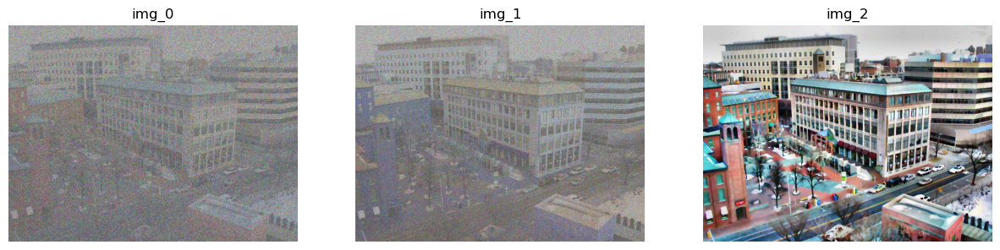

In [71]:
low_contrast_img_jpg = cv2.imread(r'img/input.jpg', cv2.IMREAD_UNCHANGED)
low_contrast_img_jpg = cv2.cvtColor(low_contrast_img_jpg , cv2.COLOR_BGR2RGB) 

low_contrast_img_png = cv2.imread(r'img/input.png' )
low_contrast_img_png = cv2.cvtColor(low_contrast_img_png , cv2.COLOR_BGR2RGB) 

output_img = cv2.imread(r'img/output.jpg', cv2.IMREAD_UNCHANGED)
output_img = cv2.cvtColor(output_img , cv2.COLOR_BGR2RGB) 

show_mult_img(1, 3, (low_contrast_img_jpg, low_contrast_img_png, output_img))

## equalizeHist

In [72]:
# convert image from BGR to HSV
img_hsv = low_contrast_img_jpg.copy()
img_hsv_png = low_contrast_img_png.copy()

img_hsv = cv2.cvtColor(img_hsv, cv2.COLOR_BGR2HSV)
img_hsv_png = cv2.cvtColor(img_hsv_png, cv2.COLOR_BGR2HSV)

# Histogram equalisation on the V-channel
img_hsv[:, :, 2] = cv2.equalizeHist(img_hsv[:, :, 2])
img_hsv_png[:, :, 2] = cv2.equalizeHist(img_hsv_png[:, :, 2])

# now the img_hsv has equalized
# now convert hsv image back from HSV to RGB
imgequalized = cv2.cvtColor(img_hsv, cv2.COLOR_HSV2BGR)
imgequalized_png = cv2.cvtColor(img_hsv_png, cv2.COLOR_HSV2BGR)
 

## clahe

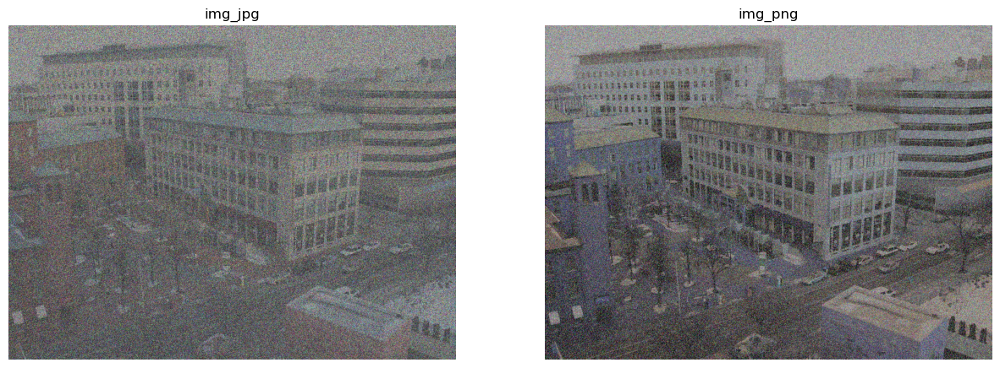

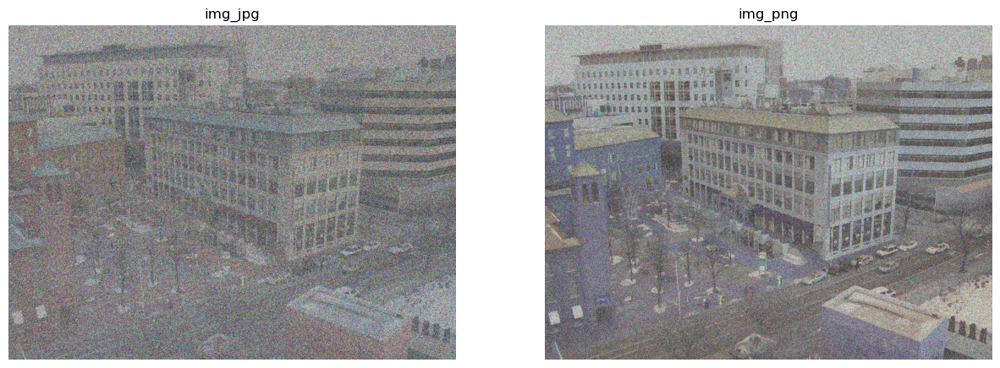

In [73]:
img_yuv = low_contrast_img_jpg.copy()
img_yuv_png = low_contrast_img_png.copy()

img_yuv = cv2.cvtColor(img_yuv , cv2.COLOR_BGR2YUV)
img_yuv_png = cv2.cvtColor(img_yuv_png , cv2.COLOR_BGR2YUV)

clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(2,2))

img_yuv[:,:,0] = clahe.apply(img_yuv[:,:,0])
img_yuv_png[:,:,0] = clahe.apply(img_yuv_png[:,:,0])

img = cv2.cvtColor(img_yuv, cv2.COLOR_YUV2BGR)
img_png = cv2.cvtColor(img_yuv_png, cv2.COLOR_YUV2BGR)

show_mult_img_JPG_PNG(1, 2, (imgequalized, imgequalized_png))
show_mult_img_JPG_PNG(1, 2, (img, img_png))


# Denoising

## Kernel

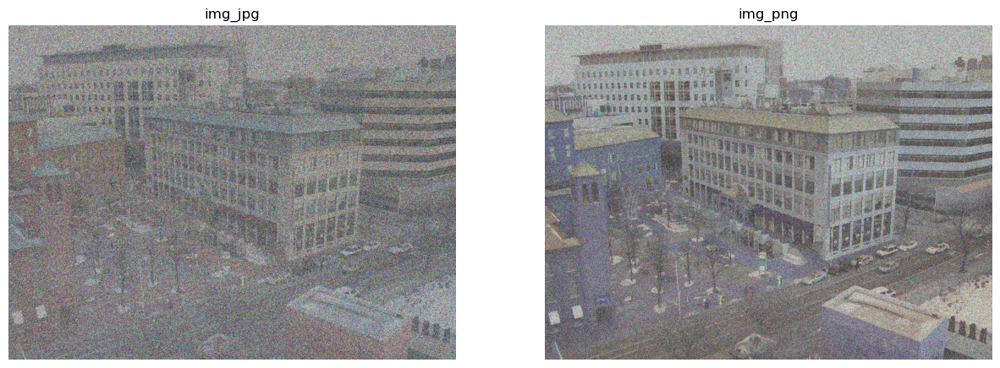

In [74]:
kernel = np.array([[0, 0, 0, 0, 0], 
                  [0, 0, 0, 0, 0], 
                  [0, 0, 1, 0, 0], 
                  [0, 0, 0, 0, 0], 
                  [0, 0, 0, 0, 0]])

low_contrast_img_jpg_2 = img.copy()
low_contrast_img_png_2 = img_png.copy()

convolved_img_jpg = cv2.filter2D(src=low_contrast_img_jpg_2, ddepth=-1, kernel=kernel)
convolved_img_png = cv2.filter2D(src=low_contrast_img_png_2, ddepth=-1, kernel=kernel)

show_mult_img_JPG_PNG(1, 2, (convolved_img_jpg, convolved_img_png))


## Box filter

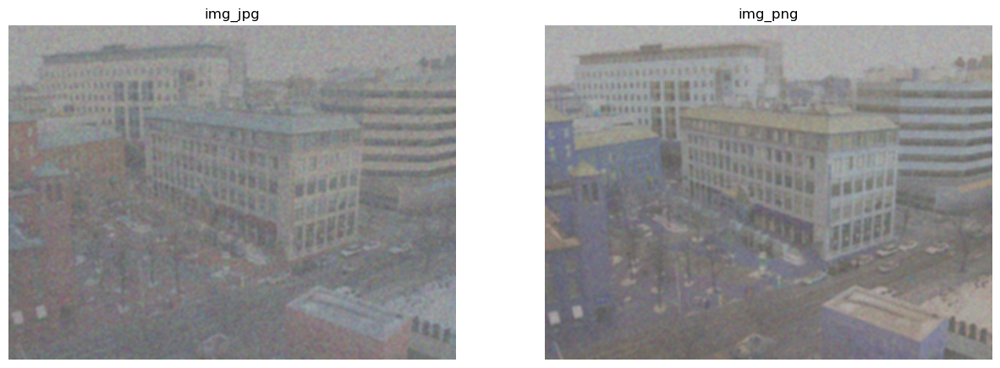

In [87]:
salt_pepper_noise_img_jpg_2 = low_contrast_img_jpg.copy()
salt_pepper_noise_img_png_2 = low_contrast_img_png.copy()

box_salpep_img_jpg = cv2.blur(salt_pepper_noise_img_jpg_2, (17, 17))
box_salpep_img_png = cv2.blur(salt_pepper_noise_img_png_2, (17, 17))

show_mult_img_JPG_PNG(1, 2, (box_salpep_img_jpg, box_salpep_img_png))

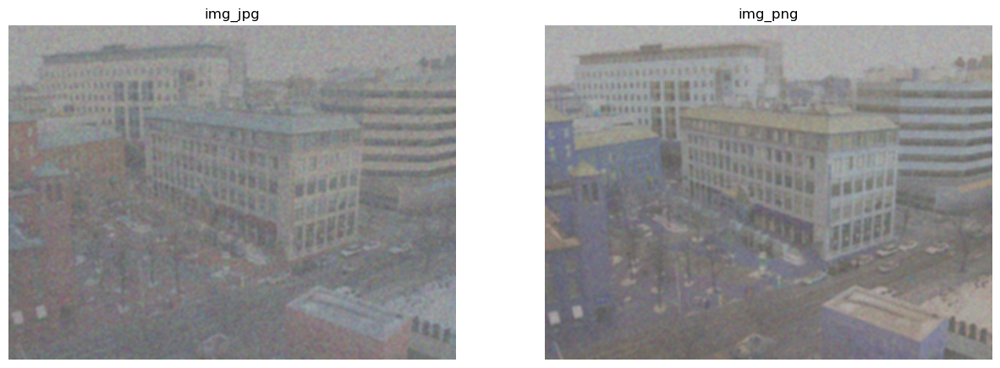

In [88]:
salt_pepper_noise_img_jpg_3 = low_contrast_img_jpg.copy()
salt_pepper_noise_img_png_3 = low_contrast_img_png.copy()

box_salpep_img_jpg_4 = cv2.boxFilter(salt_pepper_noise_img_jpg_3, -1, (17, 17))
box_salpep_img_png_4 = cv2.boxFilter(salt_pepper_noise_img_png_3, -1, (17, 17))

show_mult_img_JPG_PNG(1, 2, (box_salpep_img_jpg_4, box_salpep_img_png_4))

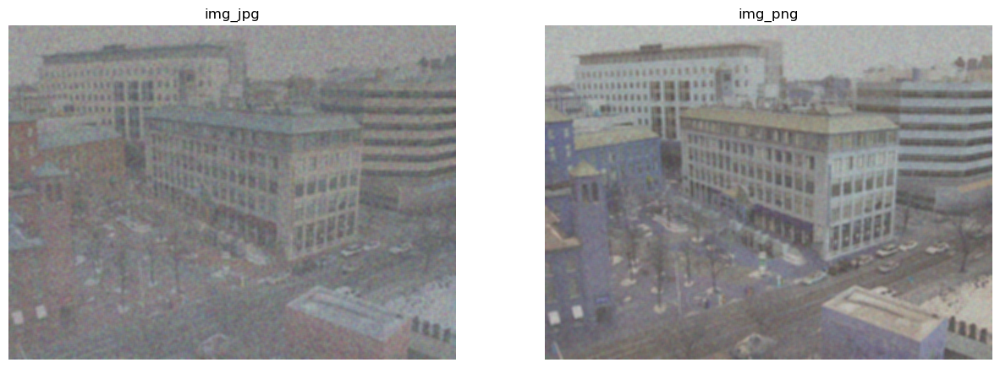

In [76]:
salt_pepper_noise_img_jpg_  = img.copy()
salt_pepper_noise_img_png_  = img_png.copy()

box_salpep_img_jpg_ = cv2.blur(salt_pepper_noise_img_jpg_ , (17, 17))
box_salpep_img_png_ = cv2.blur(salt_pepper_noise_img_png_ , (17, 17))

show_mult_img_JPG_PNG(1, 2, (box_salpep_img_jpg_, box_salpep_img_png_))

## Gaussian Filter

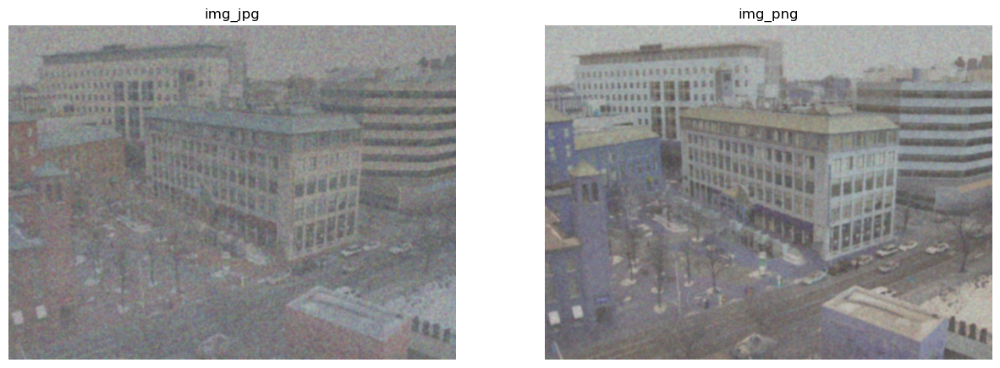

In [77]:
gaus_noise_img_jpg_ = img.copy()
gaus_noise_img_png_ = img_png.copy()

gauss_gauss_img_jpg2 = cv2.GaussianBlur(gaus_noise_img_jpg_, (25, 25), 0)
gauss_gauss_img_png2 = cv2.GaussianBlur(gaus_noise_img_png_, (25, 25), 0)

show_mult_img_JPG_PNG(1, 2, (gauss_gauss_img_jpg2, gauss_gauss_img_png2))

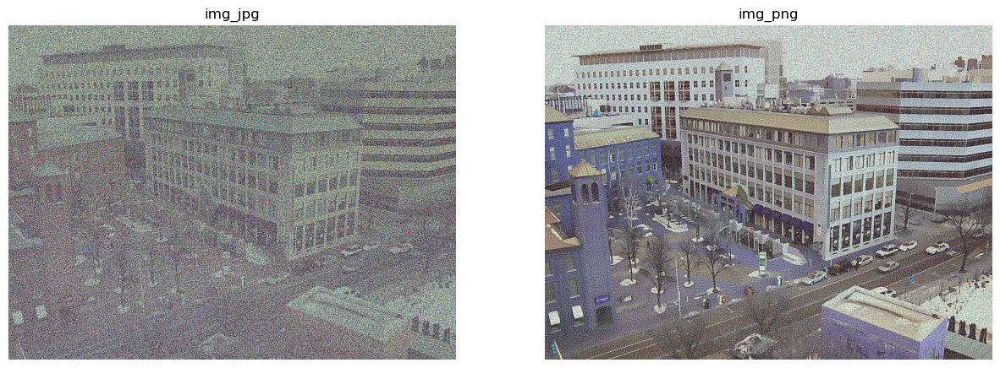

In [78]:
s1 = cv2.addWeighted(img,     3.5, gauss_gauss_img_jpg2, -2.5, 0)
s2 = cv2.addWeighted(img_png, 3.5, gauss_gauss_img_png2, -2.5, 0)

show_mult_img_JPG_PNG(1, 2, (s1, s2))

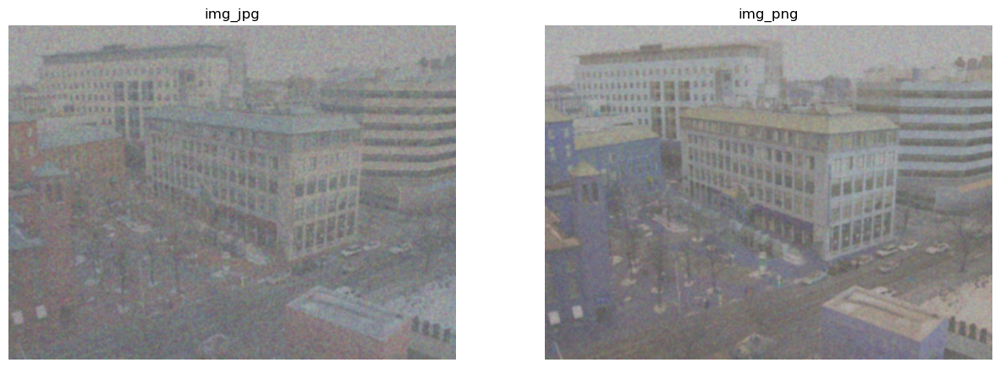

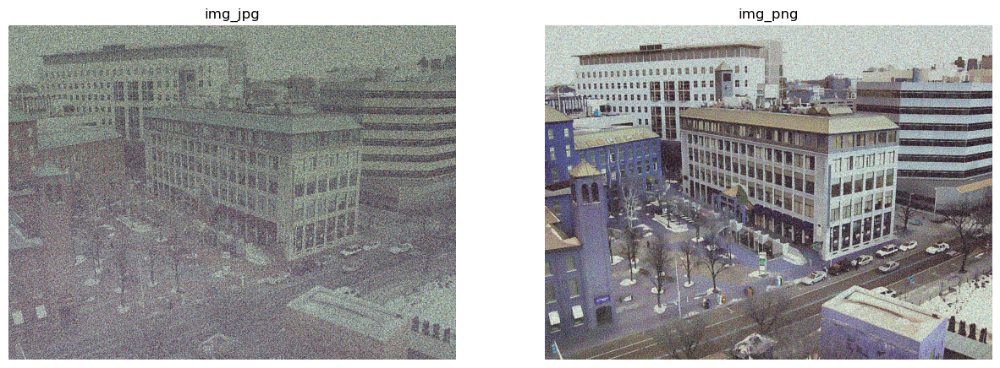

In [94]:
gaus_noise_img_jpg_3 = low_contrast_img_jpg.copy()
gaus_noise_img_png_3 = low_contrast_img_png.copy()

gauss_gauss_img_jpg3 = cv2.GaussianBlur(gaus_noise_img_jpg_3, (25, 25), 0)
gauss_gauss_img_png3 = cv2.GaussianBlur(gaus_noise_img_png_3, (25, 25), 0)

show_mult_img_JPG_PNG(1, 2, (gauss_gauss_img_jpg3, gauss_gauss_img_png3))

s3 = cv2.addWeighted(img,     3.5, gauss_gauss_img_jpg3, -2.5, 0)
s4 = cv2.addWeighted(img_png, 3.5, gauss_gauss_img_png3, -2.5, 0)

show_mult_img_JPG_PNG(1, 2, (s3, s4))

## Median filter

The last and the best result is : 
The last and the best result is : 
The last and the best result is : 


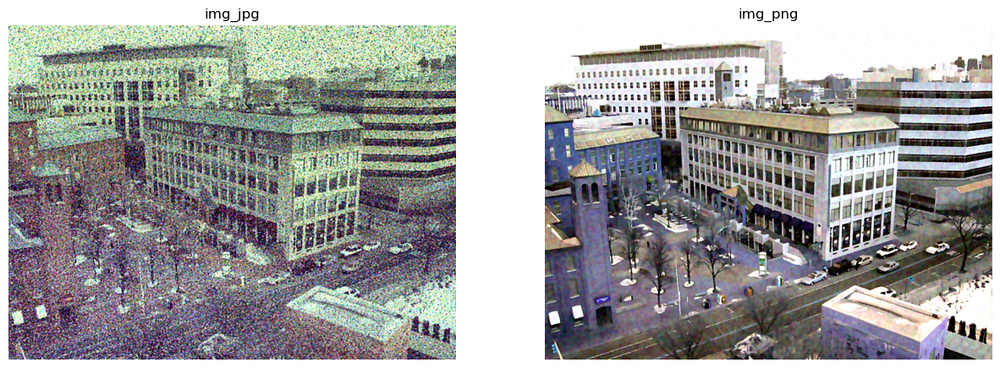

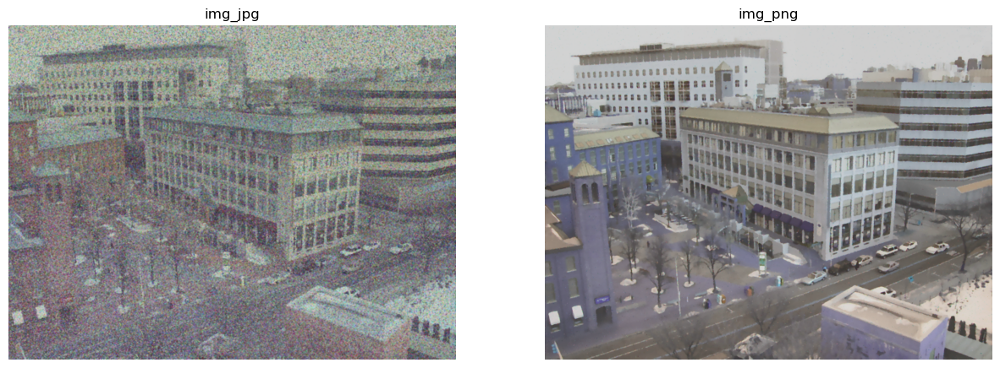

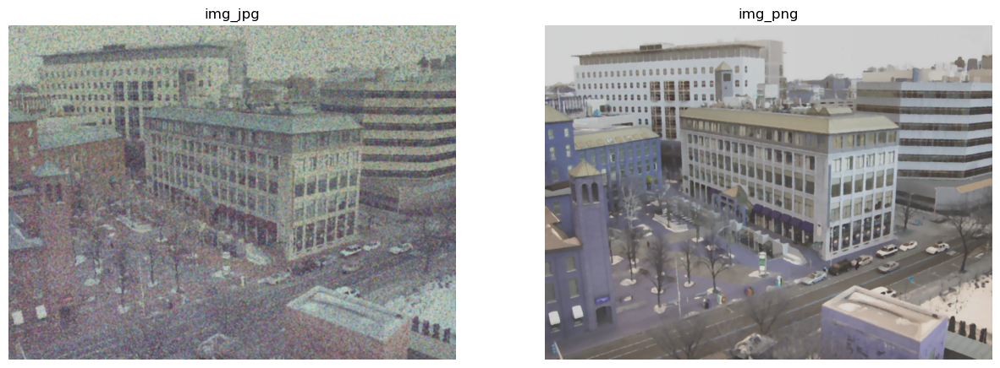

In [92]:
m_noise_img_jpg_6 = s1.copy()
m_noise_img_png_6 = s2.copy()

median_gauss_img_jpg_6 = cv2.medianBlur(m_noise_img_jpg_6, 7)
median_gauss_img_png_6 = cv2.medianBlur(m_noise_img_png_6, 7)

print('The last and the best result is : ')
show_mult_img_JPG_PNG(1, 2, (median_gauss_img_jpg_6, median_gauss_img_png_6))


m_noise_img_jpg_ = img.copy()
m_noise_img_png_ = img_png.copy()

median_gauss_img_jpg_2 = cv2.medianBlur(m_noise_img_jpg_, 7)
median_gauss_img_png_2 = cv2.medianBlur(m_noise_img_png_, 7)

print('The last and the best result is : ')
show_mult_img_JPG_PNG(1, 2, (median_gauss_img_jpg_2, median_gauss_img_png_2))


median_gauss_img_jpg_5 = cv2.medianBlur(median_gauss_img_jpg_2, 7)
median_gauss_img_png_5 = cv2.medianBlur(median_gauss_img_png_2, 7)

print('The last and the best result is : ')
show_mult_img_JPG_PNG(1, 2, (median_gauss_img_jpg_5, median_gauss_img_png_5))

The last and the best result is : 


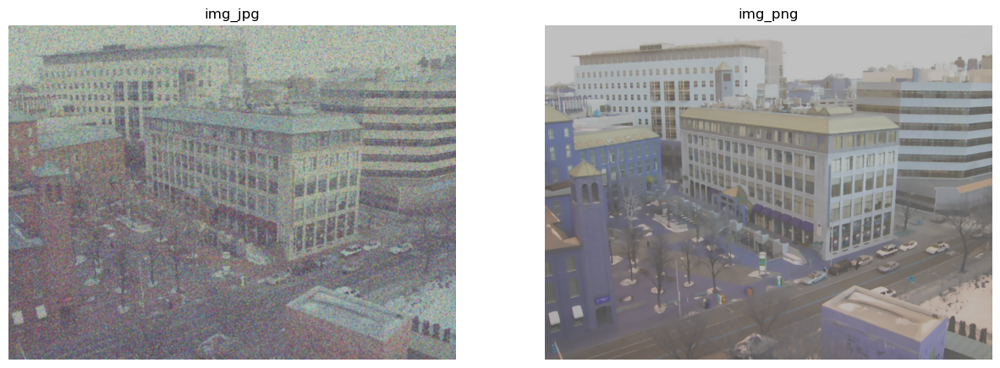

In [89]:
m_noise_img_jpg_2 = low_contrast_img_jpg.copy()
m_noise_img_png_2 = low_contrast_img_png.copy()

median_gauss_img_jpg_3 = cv2.medianBlur(m_noise_img_jpg_2, 7)
median_gauss_img_png_3 = cv2.medianBlur(m_noise_img_png_2, 7)

print('The last and the best result is : ')
show_mult_img_JPG_PNG(1, 2, (median_gauss_img_jpg_3, median_gauss_img_png_3))

The last and the best result is : 


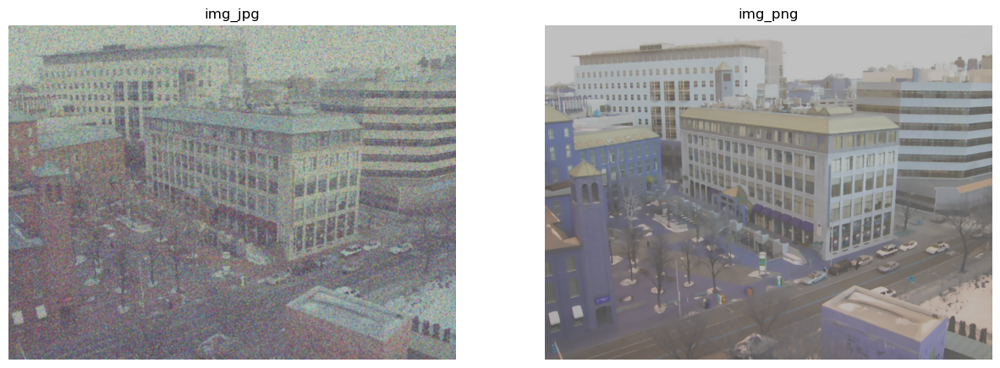

In [90]:
m_noise_img_jpg_3 = salt_pepper_noise_img_jpg_3.copy()
m_noise_img_png_3 = salt_pepper_noise_img_png_3.copy()

median_gauss_img_jpg_4 = cv2.medianBlur(m_noise_img_jpg_3, 7)
median_gauss_img_png_4 = cv2.medianBlur(m_noise_img_png_3, 7)

print('The last and the best result is : ')
show_mult_img_JPG_PNG(1, 2, (median_gauss_img_jpg_4, median_gauss_img_png_4))

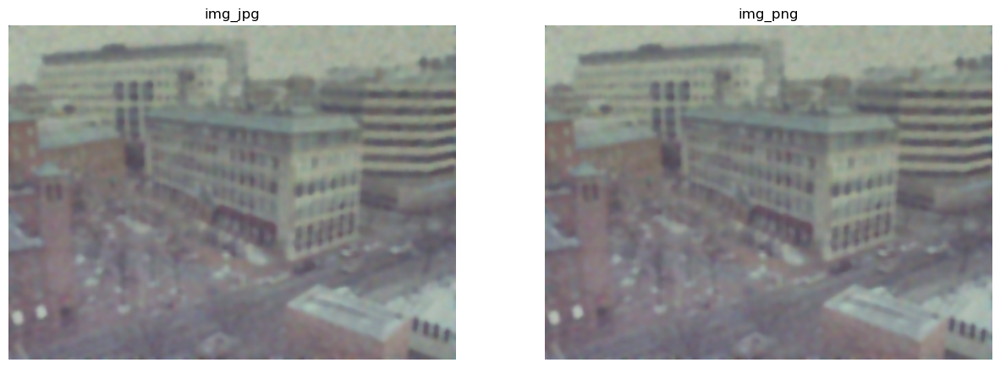

In [80]:
dst3 = cv2.fastNlMeansDenoisingColored(median_gauss_img_jpg_2,None,10,10,7,21)
dst4 = cv2.fastNlMeansDenoisingColored(median_gauss_img_png_2,None,10,10,7,21)

show_mult_img_JPG_PNG(1, 2, (dst3, dst3))

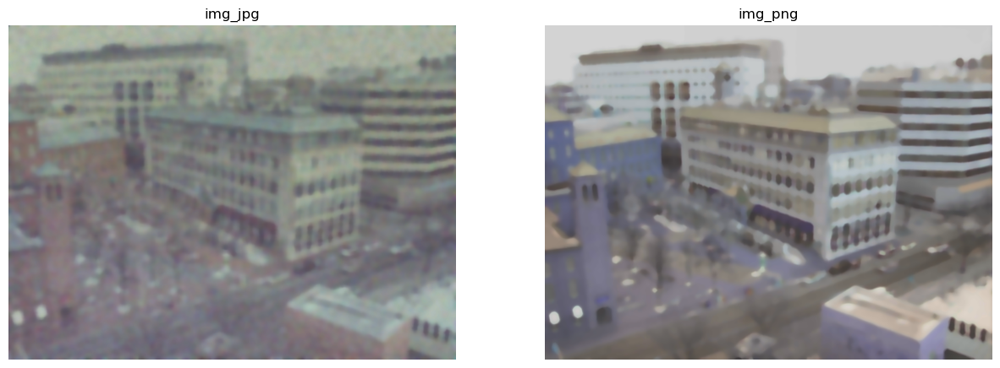

In [81]:
out_jpg = cv2.bilateralFilter(dst3, 5, 6, 6)
out_png = cv2.bilateralFilter(dst4, 5, 6, 6)

show_mult_img_JPG_PNG(1, 2, (out_jpg, out_png))

## Color Image

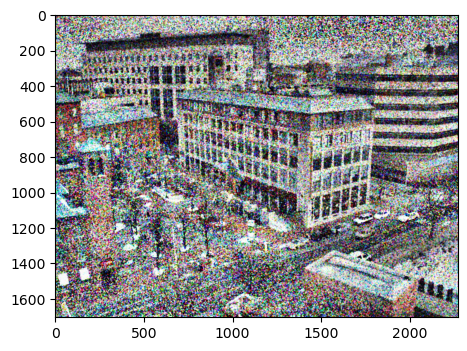

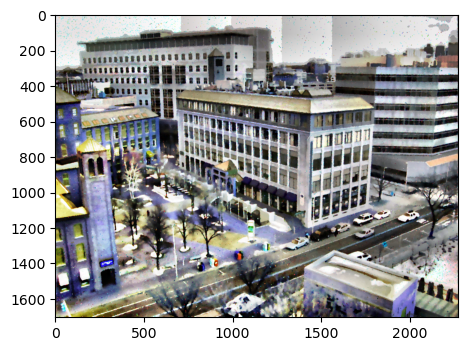

In [103]:
clahe2 = cv2.createCLAHE(clipLimit = 50)

r_j, g_j, b_j = cv2.split(img)

r_j = cv2.medianBlur(r_j, 5)
g_j = cv2.medianBlur(g_j, 5)
b_j = cv2.medianBlur(b_j, 5)

r_j = cv2.medianBlur(r_j, 5)
g_j = cv2.medianBlur(g_j, 5)
b_j = cv2.medianBlur(b_j, 5)

r_j = clahe2.apply(r_j)
g_j = clahe2.apply(g_j)
b_j = clahe2.apply(b_j)

r_p, g_p, b_p = cv2.split(img_png)

r_p = cv2.medianBlur(r_p, 5)
g_p = cv2.medianBlur(g_p, 5)
b_p = cv2.medianBlur(b_p, 5)

r_p = cv2.medianBlur(r_p, 5)
g_p = cv2.medianBlur(g_p, 5)
b_p = cv2.medianBlur(b_p, 5)

r_p = clahe2.apply(r_p)
g_p = clahe2.apply(g_p)
b_p = clahe2.apply(b_p)

jpg_image = cv2.merge((r_j, g_j, b_j))
png_image = cv2.merge((r_p, g_p, b_p))

#show_mult_img(1, 2, (jpg_image , png_image))
show_img_plt( jpg_image   )
show_img_plt( png_image )


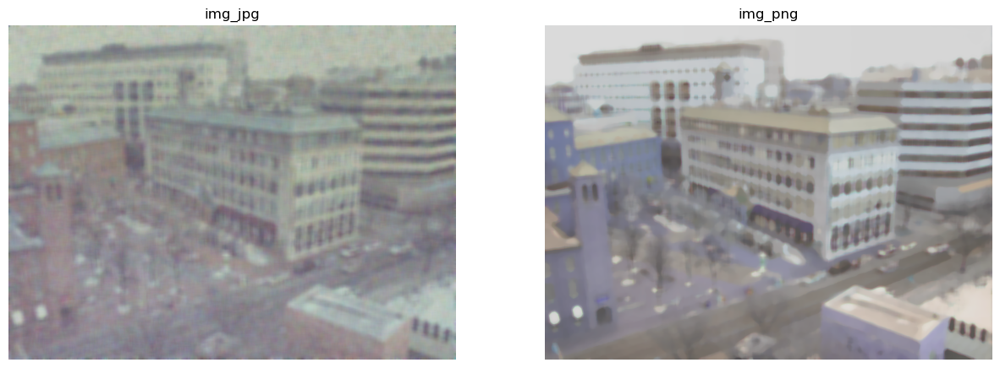

In [83]:
Gamma_jpg = fun_Gamma(median_gauss_img_jpg_2 ,0.8)
Gamma_png = fun_Gamma(median_gauss_img_png_2 ,0.8)

show_mult_img_JPG_PNG(1, 2, (Gamma_jpg, Gamma_png))
 

In [ ]:

def minimumBoxFilter(n, img): 

  # Creates the shape of the kernel
  size = (n, n)
  shape = cv2.MORPH_RECT
  kernel = cv2.getStructuringElement(shape, size)

  # Applies the minimum filter with kernel NxN
  imgResult = cv2.erode(img, kernel)

  # Shows the result
  cv2.namedWindow('Result with n ' + str(n), cv2.WINDOW_NORMAL) # Adjust the window length
  return imgResult 


def maximumBoxFilter(n, img): 

  # Creates the shape of the kernel
  size = (n,n)
  shape = cv2.MORPH_RECT
  kernel = cv2.getStructuringElement(shape, size)

  # Applies the maximum filter with kernel NxN
  imgResult = cv2.dilate(img, kernel)

  # Shows the result
  cv2.namedWindow('Result with n ' + str(n), cv2.WINDOW_NORMAL) # Adjust the window length
  return imgResult 
